# 0. Wiederholung: Freies Teilchen

Die Schrödinger-Gleichung eines freien Teilchens in einer Dimension lautet:

$$
-\frac{\partial^2 }{\partial x^2} \Psi(x) = E \Psi(x)
$$

Diese lässt sich umformulieren zu:

$$
\frac{\partial^2 }{\partial x^2} \Psi(x) = -k^2 \Psi(x)~~~\text{mit}~k=\sqrt{E}~\forall~E \geq 0
$$

Diese lineare, homogene Differentialgleichung zweiter Ordnung ist identisch zum einfachen harmonischen Oszillator. Dessen allgemeine Lösung ist:

$$
\Psi(x) = c_1 \cdot e^{ikx} + c_2 \cdot e^{-ikx}
$$

Das freie Teilchen befindet sich also in einer Superposition von Wellenfunktionen verschiedener Phasen, die beliebige Energiewerte durch $k$ annehmen können.

Allgemein gehen wir zum Lösen der Schrödinger-Gleichung (SG) folgendermaßen vor:

   1. Aufstellen des Hamilton-Operators
   2. "educated guess" der Wellenfunktion
   3. Einsetzen von Randbedingungen
   4. Differentialgleichung in bekanntes Problem umformen

# 1. Seminar: Translation und Schwingung

## 1. Translation: Teilchen im Kasten
### a) Lösen der Schrödinger-Gleichung

$$
\hat{H} = - \frac{\partial^2}{\partial x^2} + U(x), ~~~U(x) =
    \begin{cases}
      0, & \text{für }\  0 \leq x \leq L \\
      \infty, & \text{für}\ (x < 0, x > L) 
    \end{cases}
$$

Allgemeiner Ansatz:

$$
\Psi_{k}(x) =A e^{i k x}+B e^{-i k x}
$$

Weil das Potential an den Wänden unendlich hoch ist, muss diese dort stetig gegen 0 streben.

$$
\Psi_{k}(x \rightarrow 0, x \rightarrow L) = Ae^0 + Be^0 = 0 \\
\therefore A = -B
$$

Da A und B constant sind, gilt für den Kasten:

$$
\Psi_{k}(x) = A [{\cos(kx)} + i\sin(kx) - {\cos(kx)} + i\sin(kx)] \\
\Psi_{k}(x) = A \sin(kx)
$$
Wobei wir die Faktoren und $i$ in A kombiniert haben. Generell gilt, dass $A~\in~\mathbb{C}$.

Für $x = L$ gilt:

$$
\Psi_{k}(L) = A \sin(kL) = 0
$$

Das ist erfüllt wenn $kL = n\pi$, wobei $n=1,2,3 ...$ Der Fall $n=0$ impliziert $k=0$, sodass $\Psi_k(x) = 0~\forall~x~\in~\mathbb{R}$, deswegen entfällt er (Born'sche Interpretation). Der Fall $n=-1,-2,-3...$ ist zwar möglich, gibt aber die qualitativ gleiche Lösung.

Im Kasten verhält sich das Teilchen wie ein freies Teilchen. Daraus folgt für die Energie mit diesen Randbedingungen:

$$
E_n = \frac{\hbar^2 k_n^2}{2m} = \frac{\hbar^2 (n\pi)^2}{2mL^2} = \frac{h n^2}{8mL^2}
$$

Die Normierungsbedingung für die Wellenfunktion lautet:

$$
\int_0^L |\Psi_{k}(x)|^2 dx = \int_0^L \left| A \sin\left(\frac{n\pi x}{L}\right) \right| ^2 dx = 1
$$

Mit der Hilfestellung $\int \sin^2(ax)dx = \frac{x}{2} - \frac{\sin(2ax)}{4a}$ vereinfacht sich dieses zu:

$$
\int_0^L |\Psi_{k}(x)|^2 dx = |A|^2 \left[ \frac{x}{2} - \underbrace{\frac{\sin(2\pi nx/L)}{4n\pi /L}}_{0~\text{für x=L, x=0}}   \right]^L_0 ~~\because \sin(2\pi n) = 0 ~\forall~n=1,2,3... \\
$$

Daraus folgt:

$$
1 = |A|^2 \frac{L}{2} ~\rightarrow ~ A = \sqrt{\frac{2}{L}}e^{i\phi}
$$

Dabei ist $e^{i\phi}$ ein komplexer Phasenfaktor. Dieser verändert den Erwartungswert (das Betragsquadrat) der Wellenfunktion nicht und wird daher üblicherweise ignoriert.

### b) + c) Skizzieren der Lösungen

In [7]:
#  HIDDEN

#HIDDEN

%matplotlib inline
%matplotib.pyplot as plt
import math
plt.xkcd()
plt.style.use("seaborn-ticks")
plt.rcParams["legend.handlelength"] = 0.8
plt.rcParams["legend.framealpha"] = 0.8
font_name = "Arial"
font_size = 12
plt.rcParams.update({"font.sans-serif": font_name, "font.size": font_size})

n = np.array([1, 2, 3, 4, 5])
x = np.arange(0, 100)

def energy(n, L):
    return n ** 2 / (8 * L ** 2)

def wavefunction(x, n, L):
    return np.sqrt(2 / L) * np.sin(x * math.pi * n / L)

def int_wavefunction(x, n, L):
    return (2/L) * ((x/2) - (L/(4*n*math.pi)) * np.sin((2*n * math.pi * x) / L))

def square_wavefunction(x, n, L):
    return (np.sqrt(2 / L) * np.sin(x * math.pi * n / L))**2

fig, ax = plt.subplots(1,3 ,figsize=(15,5), sharey=True)
for i in n:
    ax[0].hlines(energy(i, 100), 0, 100)
    ax[0].plot(x, wavefunction(x, i, 100) / 5000 + energy(i, 100), color="crimson")
    ax[0].set_yticks(energy(n, 100))
    ax[0].set_yticklabels(["n = {}".format(i) for i in n])
    ax[0].set_xticks([0, 100])
    ax[0].set_xticklabels([0, "L"])
    ax[0].set_title("$\Psi(x)$")

for i in n:
    ax[1].hlines(energy(i, 100), 0, 100)
    ax[1].plot(x, square_wavefunction(x, i, 100) / 600 + energy(i, 100), color="crimson")
    ax[1].set_yticks(energy(n, 100))
    ax[1].set_yticklabels(["n = {}".format(i) for i in n])
    ax[1].set_xticks([0, 100])
    ax[1].set_xticklabels([0, "L"])
    ax[1].set_title("$\Psi(x)^2$")
    
for i in n:
    ax[2].hlines(energy(i, 100), 0, 100)
    ax[2].plot(x, int_wavefunction(x, i, 100) / 20000 + energy(i, 100), color="crimson")
    ax[2].fill_between(np.arange(45, 95), energy(i, 100), int_wavefunction(np.arange(45, 95), i, 100)/20000 + 
                       energy(i,100), color="blue", alpha=0.5)
    ax[2].set_yticklabels(["n = {}".format(i) for i in n])
    ax[2].set_xticks([0, 45, 95, 100])
    ax[2].set_xticklabels([0, "0.45 L", "0.95 L", "L"])
    ax[2].set_title("$\int_0^L \Psi(x)^2$ dx")    
    

plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

### d) Aufenthaltswahrscheinlichkeitsdichte
Im Bereich von 0.45 und 0.95 L lässt sich durch Einsetzen in das Integral herausfinden, dass das Teilchen zu 50 % in diesem Längenabschnitt ist (für $n=2$).


### e) Länge des Kastens
Ein zweiter Kasten hat die Länge L'. Wie groß muss L' sein, damit die Energie des fünften Niveaus $E_5(L')$ gleich der Energie des dritten Niveaus des ersten Kastens $E_3(L)$ ist?

$$
E_3(L) = 9h^2/8mL^2 == E_5(L') = 25h^2/8mL'^2\\
25 L^2 = 9 L'^2 \\
L' = 5/3 L
$$

## 2. Translation im zweidimensionalen Kasten
Die Bewegunsgleichung lautet:

$$
-\underbrace{\left( \frac{\partial^2 \Psi(x,y)}{\partial x^2} + \frac{\partial^2 \Psi(x,y)}{\partial y^2} \right)}_{=\hat{T}\Psi(x,y)} + \hat{U}\Psi(x,y) = E\Psi(x,y)
$$

Als Ansatz wählen wir für das Potential $U_{xy}(x,y)$:

$$
U_{xy}(x,y) = U_x(x) + U_y(y) =    
    \begin{cases}
      0, & \text{für }\  0 \leq x \cap y \leq L \\
      \infty, & \text{für}\ (x < 0, (x \cap y)  > L) 
    \end{cases}
$$

Daraus folgt, dass wir die Lösung dieser Differentialgleichung als Produkt einzelner Wellenfunktionen darstellen können:

$$
\Psi(x,y) = \psi_x(x) \cdot \psi_x(y)
$$

Setzen wir dies in die SG ein, folgt:

$$
\left(\underbrace{\hat{H}_x}_{=\hat{T}_x + \hat{U}_x} + \underbrace{\hat{H}_y}_{=\hat{T}_x + \hat{U}_x} \right) \left(\psi_x(x) \cdot \psi_y(y)\right) = E\left(\psi_x(x) \cdot \psi_y(y)\right)
$$

Dieser Hamilton-Operator ist linear und distributiv:

$$
\hat{H}_x \psi_x(x)\psi_y(y) + \hat{H}_y \psi_x(x)\psi_y(y) = E \psi_x(x)\psi_y(y) \\
$$

Dies kommutiert zu:

$$
\psi_y(y)\cdot \hat{H}_x \psi_x(x) + \psi_x(x)\cdot \hat{H}_y\psi_y(y) = E \psi_x(x)\psi_y(y) \\
$$

Die einzelnen Operatoren wirken dabei nur auf die einzelne Wellenfunktion:

$$
\psi_y(y)\cdot \varepsilon_x \psi_x(x) + \psi_x(x)\cdot \varepsilon_y\psi_y(y) = E \psi_x(x)\psi_y(y) \\
\left( \varepsilon_x + \varepsilon_y\right) \psi_x(x)\psi_y(y) = E \psi_x(x)\psi_y(y)
$$

Da $\varepsilon_x$, $\varepsilon_y$ und $E$ Konstanten sind, vereinfacht sich durch Normierung $\int_0^\infty |\psi_x(x)\psi_y(y)|^2 d\tau = 1$:

$$
\varepsilon_x + \varepsilon_y = E
$$

Die Lösung jeder einzelnen Wellenfunktion $\psi_i(i)$ entspricht somit der Lösung des Teilchens im 1D Kasten. Die gesamte Wellenfunktion ist als Produkt gegeben:

$$
\Psi_{x,y}(x,y) = \frac{2}{\sqrt{L_x L_y}}\sin\left(\frac{n_x \pi x}{L_x}\right)\sin\left(\frac{n_y \pi y}{L_y}\right)
$$

Und die Gesamtenergie als:

$$
E = \frac{h n_x^2}{8mL_x^2} + \frac{h n_y^2}{8mL_y^2}
$$

### b) Skizzieren der Lösungen

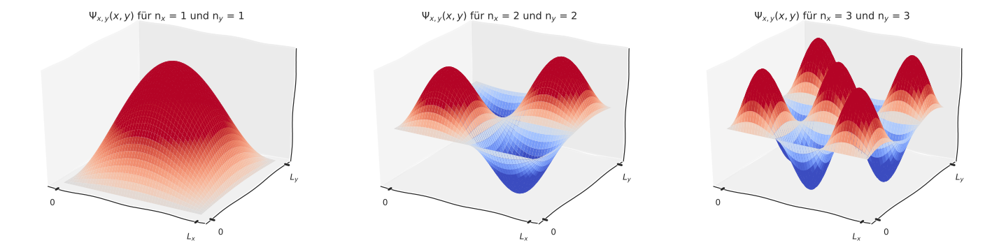

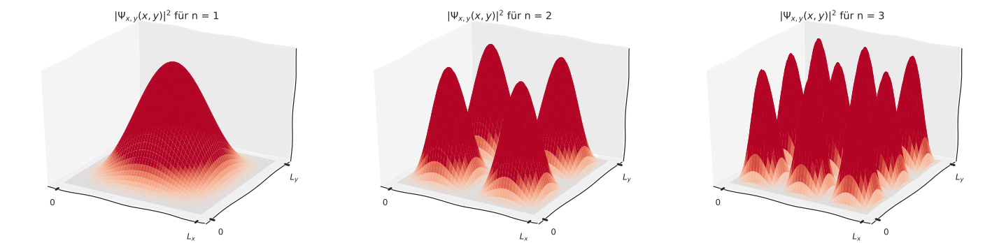

In [4]:
# HIDDEN

%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.colors as colors
from matplotlib import cm
import math
plt.xkcd()
plt.style.use("seaborn-ticks")
plt.rcParams["legend.handlelength"] = 0.8
plt.rcParams["legend.framealpha"] = 0.8
font_name = "Arial"
font_size = 12
plt.rcParams.update({"font.sans-serif": font_name, "font.size": font_size})

n = np.array([1, 2, 3])
x = y = np.arange(0, 100)
X, Y = np.meshgrid(x, y)

def energy(nx, Lx, ny, Ly):
    return nx ** 2 / (8 * Lx ** 2) + ny ** 2 / (8 * Ly ** 2)

def wavefunction(x, y, nx, ny, Lx, Ly):
    return 2/np.sqrt(Lx*Ly) * np.sin(x * math.pi * nx / Lx) *np.sin(y * math.pi * ny / Ly)

def square_wavefunction(x,y,nx,ny,Lx,Ly):
    return wavefunction(x,y,nx,ny,Lx,Ly) ** 2

fig = plt.figure(figsize=(20,5))
for i in n:
    ax = fig.add_subplot(1, 3, i, projection='3d')
    zs = np.array(wavefunction(np.ravel(X), np.ravel(Y), i, i, 100, 100))
    Z = zs.reshape(X.shape)
    ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=True, norm = colors.Normalize(vmin=-0.01,vmax=0.01))
    ax.set_title("$\Psi_{{x,y}}(x,y)$ für n$_x$ = {} und n$_y$ = {}".format(i, i))
    ax.set_xticklabels([0, "$L_x$"])
    ax.set_xticks([0, 100])
    ax.set_yticklabels([0, "$L_y$"])
    ax.set_yticks([0, 100])
    ax.set_zticks([])
    ax.set_zticklabels([])
plt.tight_layout()

fig = plt.figure(figsize=(20,5))
for i in n:
    ax = fig.add_subplot(1, 3, i, projection='3d')
    zs = np.array(square_wavefunction(np.ravel(X), np.ravel(Y), i, i, 100, 100))
    Z = zs.reshape(X.shape)
    ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=True, norm = colors.Normalize(vmin=-0.0001,vmax=0.0001))
    ax.set_title("$|\Psi_{{x,y}}(x,y)|^2$ für n = {}".format(i))
    ax.set_xticklabels([0, "$L_x$"])
    ax.set_xticks([0, 100])
    ax.set_yticklabels([0, "$L_y$"])
    ax.set_yticks([0, 100])
    ax.set_zticks([])
    ax.set_zticklabels([])    
plt.tight_layout()
plt.show()

#### Rechteckiger Kasten:
$5 L_x = L_y $

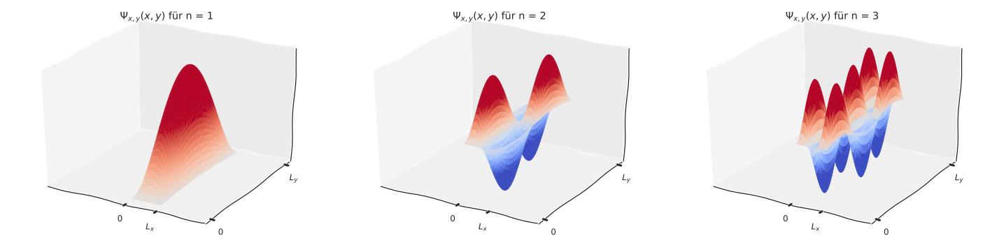

In [3]:
# HIDDEN

%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.colors as colors
from matplotlib import cm
import math
plt.xkcd()
plt.style.use("seaborn-ticks")
plt.rcParams["legend.handlelength"] = 0.8
plt.rcParams["legend.framealpha"] = 0.8
font_name = "Arial"
font_size = 12
plt.rcParams.update({"font.sans-serif": font_name, "font.size": font_size})

n = np.array([1, 2, 3])
x = np.arange(0, 100)
y = np.arange(0, 500)
X, Y = np.meshgrid(x, y)

def energy(nx, Lx, ny, Ly):
    return nx ** 2 / (8 * Lx ** 2) + ny ** 2 / (8 * Ly ** 2)

def wavefunction(x, y, nx, ny, Lx, Ly):
    return 2/np.sqrt(Lx*Ly) * np.sin(x * math.pi * nx / Lx) *np.sin(y * math.pi * ny / Ly)

def square_wavefunction(x,y,nx,ny,Lx,Ly):
    return wavefunction(x,y,nx,ny,Lx,Ly) ** 2
fig = plt.figure(figsize=(20,5))
for i in n:
    ax = fig.add_subplot(1, 3, i, projection='3d')
    zs = np.array(wavefunction(np.ravel(X), np.ravel(Y), i, i, 100, 500))
    Z = zs.reshape(X.shape)
    ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=True, norm = colors.Normalize(vmin=-0.005,vmax=0.005))
    ax.set_title("$\Psi_{{x,y}}(x,y)$ für n = {}".format(i))
    ax.set_xticklabels([0, "$L_x$"])
    ax.set_xticks([0, 100])
    ax.set_yticklabels([0, "$L_y$"])
    ax.set_yticks([0, 500])
    ax.set_zticks([])    
    ax.set_zticklabels([])
    ax.set_xlim([-250, 250])
plt.tight_layout()    
plt.show()

#### 3D-Kasten

Ohne Herleitung gilt, dass auch die Lösungen des dreidimensionalen Kastens unabhängig voneinander ebene Wellen in jeder Raumrichtung sind. Diese sind nur schwieriger darzustellen. Hier ist das **"Orbital"** für $n_x = n_y = n_z = 1$ entlang einer Isofläche gleicher Wahrscheinlichkeit gezeigt:

<img src="Pictures/particle_3d_box.png" alt="Drawing" style="width: 300px;"/>

Und für $n_x = n_y = n_z = 2$:

<img src="Pictures/particle_3d_box_n2.png" alt="Drawing" style="width: 300px;"/>

### c) Normierung

Die Wellenfunktion ist normiert:

$$
\begin{aligned}
\int_{x=0}^{L_x} \int_{y=0}^{L_y} \left| \Psi_{x,y}(x,y) \right|^2 dx dy 
    &= \int_{x=0}^{L_x} \left| \psi_x(x) \right|^2 dx \cdot \int_{y=0}^{L_y} \left| \psi_y(y) \right|^2 dy \\
&= \frac{4}{L_x L_y} \left[\frac{L_x}{2} -\frac{\sin(2\pi n_x x /L_x)}{4 \pi n_x/L_x} \right]_0^{L_x}
\left[\frac{L_y}{2} -\frac{\sin(2\pi n_y y /L_y)}{4 \pi n_y/L_y} \right]_0^{L_y} \\
&= \frac{4}{L_x L_y} \frac{L_x}{2}\frac{L_y}{2}\\
&= 1
\end{aligned}
$$


# 3. Schwingung: Harmonischer Oszillator

Das Potential des harmonischen Oszillators in einer Dimension lautet:
$$
U(x) = \frac{1}{2} kx^2
$$

Für dieses Potential ergeben sich folgende Lösungen der Schrödingergleichung:
$$
E_n = \hbar \omega \left( n + \frac{1}{2} \right) ~~~ \omega = \frac{\hbar k^2}{m} \\
\Psi_n(x') = \underbrace{\sqrt{ \frac{1}{2^n n! \sqrt{\pi} }}}_{\text{Normierungskoeffizient}~C_n} 
\cdot \underbrace{H_n(x')}_{\text{Hermit-Polynom}} 
\cdot \underbrace{e^-\frac{x'^2}{2}}_{\text{Gauss-Kurve}} ~~\text{mit}~~x'= x \cdot \left(\frac{\hbar^2}{mk}\right)^{\left(\frac{-1}{4}\right)}
$$

Die sogenannten Hermitschen Polynome sind Lösungen spezieller Differentialgleichungen, die man nachschlagen kann. Die ersten drei Lösungen lauten:
$$
\begin{aligned}
E_0 = \frac{\hbar \omega}{2}  &\rightarrow \Psi_0(x') = \sqrt{ \frac{1}{\sqrt{\pi} }} e^-\frac{x'^2}{2} \\ 
E_1 = \frac{3 \hbar \omega}{2}  &\rightarrow \Psi_1(x') = \sqrt{ \frac{1}{2 \sqrt{\pi} }} 2x' e^-\frac{x'^2}{2} \\ 
E_2 = \frac{5 \hbar \omega}{2}  &\rightarrow \Psi_2(x') = \sqrt{ \frac{1}{8 \sqrt{\pi} }} \left( 4x'^2 -2 \right) e^-\frac{x'^2}{2} \\ 
\end{aligned}
$$

Diese lassen sich wie folgt visualisieren:

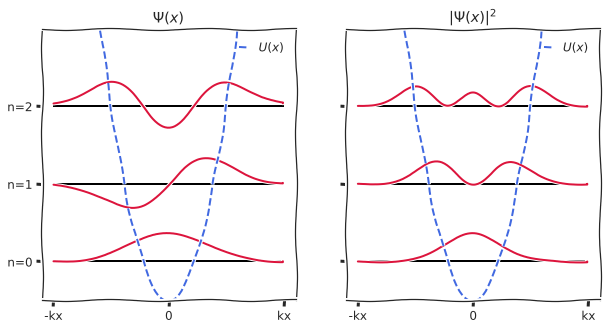

In [4]:
# HIDDEN

import numpy as np
import matplotlib.pyplot as plt
import math
plt.xkcd()
plt.style.use("seaborn-ticks")
plt.rcParams["legend.handlelength"] = 0.8
plt.rcParams["legend.framealpha"] = 0.8
font_name = "Arial"
font_size = 12
plt.rcParams.update({"font.sans-serif": font_name, "font.size": font_size})

n = np.array([0, 1, 2])
x = np.arange(-100, 100)

def energy(n, w):
    return w*(n+1/2)

def xval(x, mk):
    return x * (1/(mk))**(-1/4)

def wavefunction_n0(x):
    return np.sqrt(1/(np.sqrt(math.pi))) * np.exp(-((xval(x, 0.000001)**2)/ 2))

def wavefunction_n1(x):
    return np.sqrt(1/(2 * np.sqrt(math.pi))) * np.exp(-((xval(x, 0.000001)**2)/ 2)) * 2*xval(x, 0.000001)

def wavefunction_n2(x):
    return np.sqrt(1/(8 * np.sqrt(math.pi))) * np.exp(-((xval(x, 0.000001)**2)/ 2)) * (4*xval(x, 0.000001)**2-2)

fig, ax = plt.subplots(1,2 ,figsize=(10,5), sharey=True, sharex=True)
for i in n:
    ax[0].hlines(energy(i, 1), -100, 100)   
ax[0].plot(x, wavefunction_n0(x)/2 + energy(0, 1), color="crimson")
ax[0].plot(x, wavefunction_n1(x)/2 +  energy(1, 1), color="crimson")
ax[0].plot(x, wavefunction_n2(x)/2 + energy(2, 1), color="crimson")
ax[0].plot(x, xval(x, 0.000001)**2, color="royalblue", linestyle="--", label="$U(x)$")
ax[0].legend(loc="upper right")
ax[0].set_ylim(0, 3.5)
ax[0].set_yticks([energy(0, 1), energy(1, 1), energy(2, 1)])
ax[0].set_yticklabels(["n=0", "n=1", "n=2"])
ax[0].set_xticks([-100, 0,  100])
ax[0].set_xticklabels(["-kx", 0, "kx"])


for i in n:
    ax[1].hlines(energy(i, 1), -100, 100)   
ax[1].plot(x, wavefunction_n0(x)**2 /1.5 + energy(0, 1), color="crimson")
ax[1].plot(x, wavefunction_n1(x)**2 /1.5  +  energy(1, 1), color="crimson")
ax[1].plot(x, wavefunction_n2(x)**2 /1.5  + energy(2, 1), color="crimson")
ax[1].plot(x, xval(x, 0.000001)**2, color="royalblue", linestyle="--", label="$U(x)$")
ax[1].legend(loc="upper right")
ax[0].set_title("$\Psi(x)$")
ax[1].set_title("$|\Psi(x)|^2$")
plt.show()

Dabei sind folgende Merkmale wichtig:
- es gibt eine Nullpunktsenergie
- die Energien sind äquidistant
- Die Aufenthaltswahrscheinlichkeit sinkt mit $kx^2$, ist dadurch aber außerhalb des Potentials nicht 0!

In [5]:
# HIDDEN

import numpy as np 
import math
h = 6.626 * 10**(-34) # m2 kg / s
m = 9.109 * 10**(-31) #kg
eV = 6.2415093433 *10**(18)
nm = 10**(-9)
de = (h**2 * (49-16) * math.pi**2)/(2*m * (5 * nm)**2 * (2 * math.pi)**2) # J
de *= eV

c = 2.9979*10**(8) # m/s
h = 4.135667516 * 10**(-15) # eV*s
wavelength = h * c / de
wavelength /= nm
print("wavelength: {}, energy {}".format(wavelength, de))

def int_wavefunction(x, n, L):
    return (2/L) * ((x/2) - (L/(4*n*math.pi)) * np.sin((2*n * math.pi * x) / L))

a = int_wavefunction(0.45, 2, 1)
b = int_wavefunction(0.95, 2, 1)
print(a, b)
print(b - a)

wavelength: 2497.7963614187047, energy 0.4963702340880332
0.496774464189432 0.9967744641894319
0.49999999999999994
